In [1]:
import mne
import pickle
import numpy as np
from mne.preprocessing import ICA
import matplotlib.pyplot as plt
from functions import load_np_array_pickle
from tensorflow.keras.models import load_model
import scipy as sp
import time
from multiprocessing import Pool, cpu_count
from sklearn.cluster import KMeans
import sys
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import linkage, fcluster

Extracting parameters from ../files/eeg_files/Control1415.vhdr...
Setting channel info structure...
Reading 0 ... 810059  =      0.000 ...  1620.118 secs...


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/2916722525.py:2: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/2916722525.py:2: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/2916722525.py:2: RuntimeWarning: Not setting position of 1 misc channel found in montage:
['Resp']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)


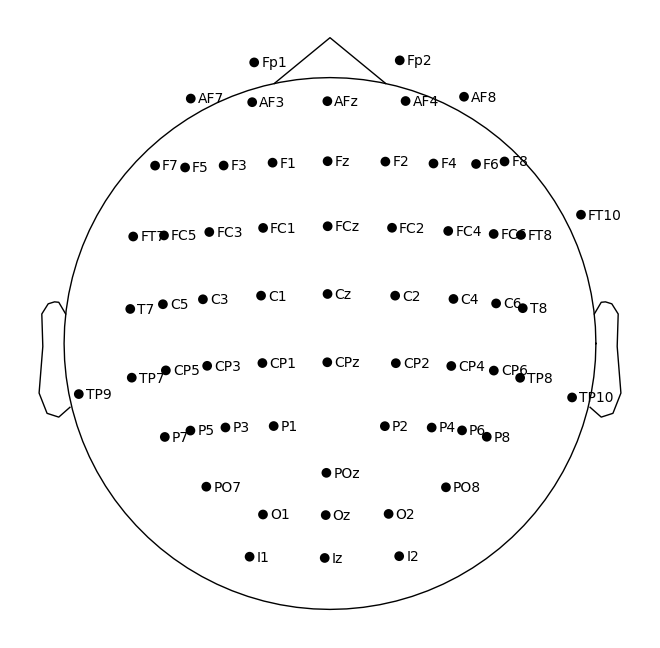

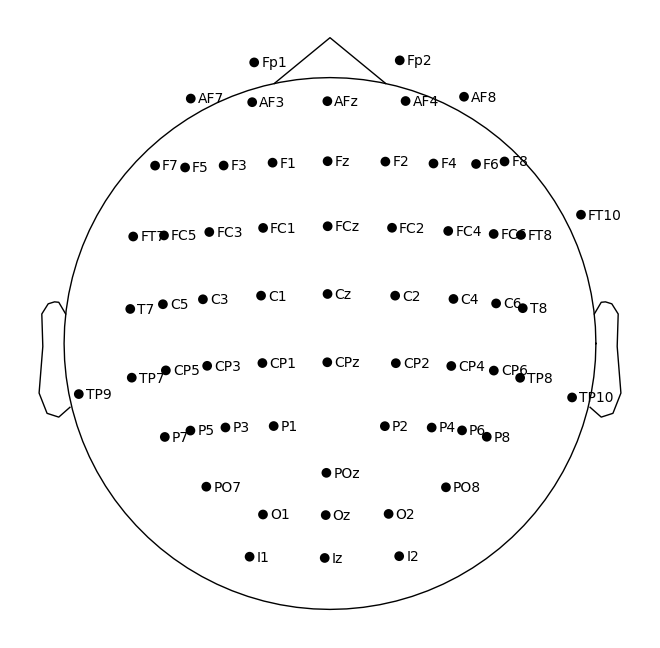

In [3]:
filename = 'Control1415.vhdr'
raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
raw.set_montage('standard_1005')
raw.plot_sensors(show_names=True)

#### Arbeiten mit annotierten Events
Viele EEG Datensätze, werden weiteren Parametern wie die Abtastrate, oder auch den verwendeten Kanälen gesichert. Bei vielen Formaten wie Brainvision werden auch Annotationen innerhalb dieser Dateien abgespeichert. Dabei wird festgehalten, wann welche Stimulation stattgefunden hat. Mittels der mne Pythonbibliothek können diese Epochen analysiert werden

Zunächst werden die Rohdaten weitesgehend gefiltert. Eine weitere Glättung und Normalisierung muss ausstehend, da durch die Glättung der Rohdaten die Abtastrate möglicherweise verändert und somit auch die zeitliche Auflösung des Signals beeinflusst werden könnte. Dadurch können die ursprünglichen Ereignisse, die auf der ursprünglichen Abtastrate basieren, möglicherweise nicht mehr genau erkannt werden. Die im nächsten Schritt erstellten Epochen wären daher unbrauchbar. Stattdessen kann man die Glättung und auch Normalisierung im Nachhinein nach Erstellung der Epochen durchführen.

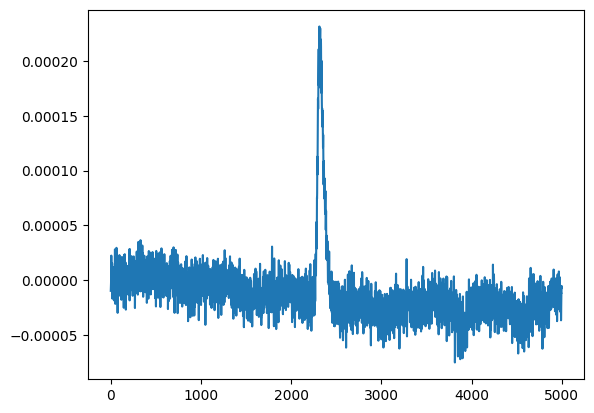

In [97]:
test = raw.get_data()
plt.plot(test[0][15000:20000])
plt.show()

Extracting parameters from ../files/eeg_files/Control1415.vhdr...
Setting channel info structure...
Reading 0 ... 810059  =      0.000 ...  1620.118 secs...


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1034722027.py:2: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1034722027.py:2: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)


Fitting ICA to data using 63 channels (please be patient, this may take a while)


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1034722027.py:2: RuntimeWarning: Not setting position of 1 misc channel found in montage:
['Resp']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1034722027.py:14: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by non-zero PCA components: 63 components
Fitting ICA took 100.1s.


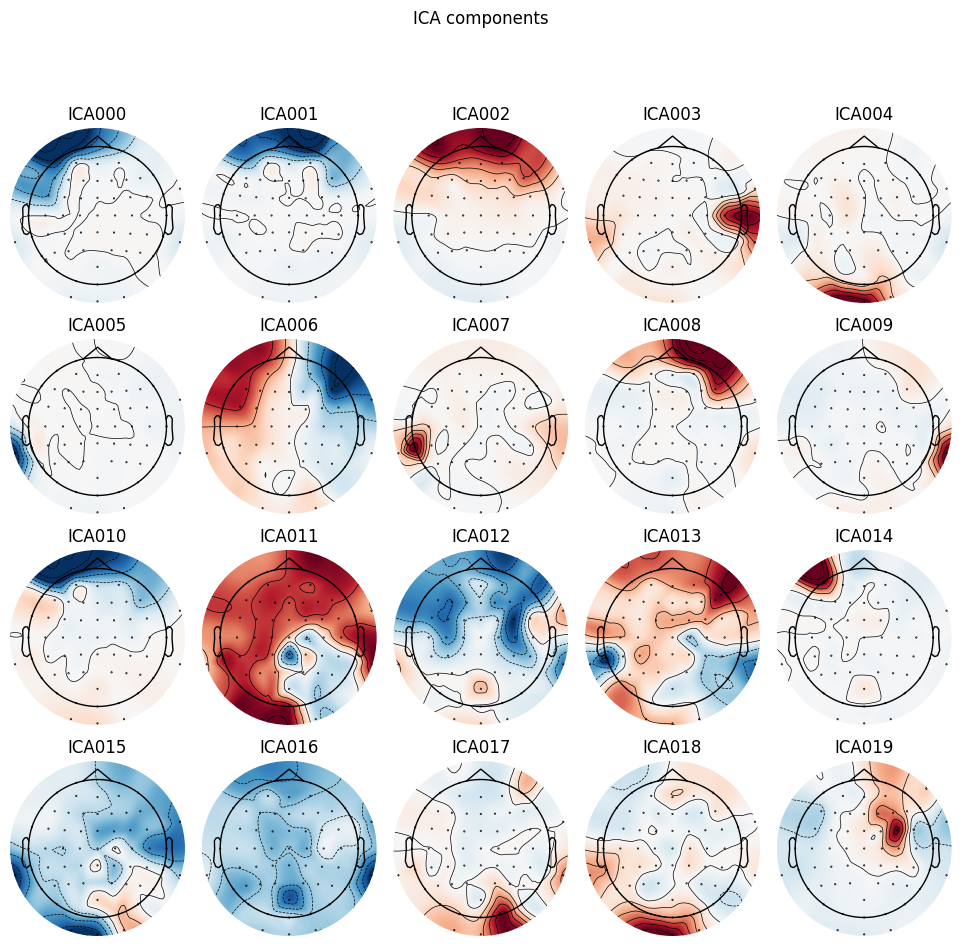

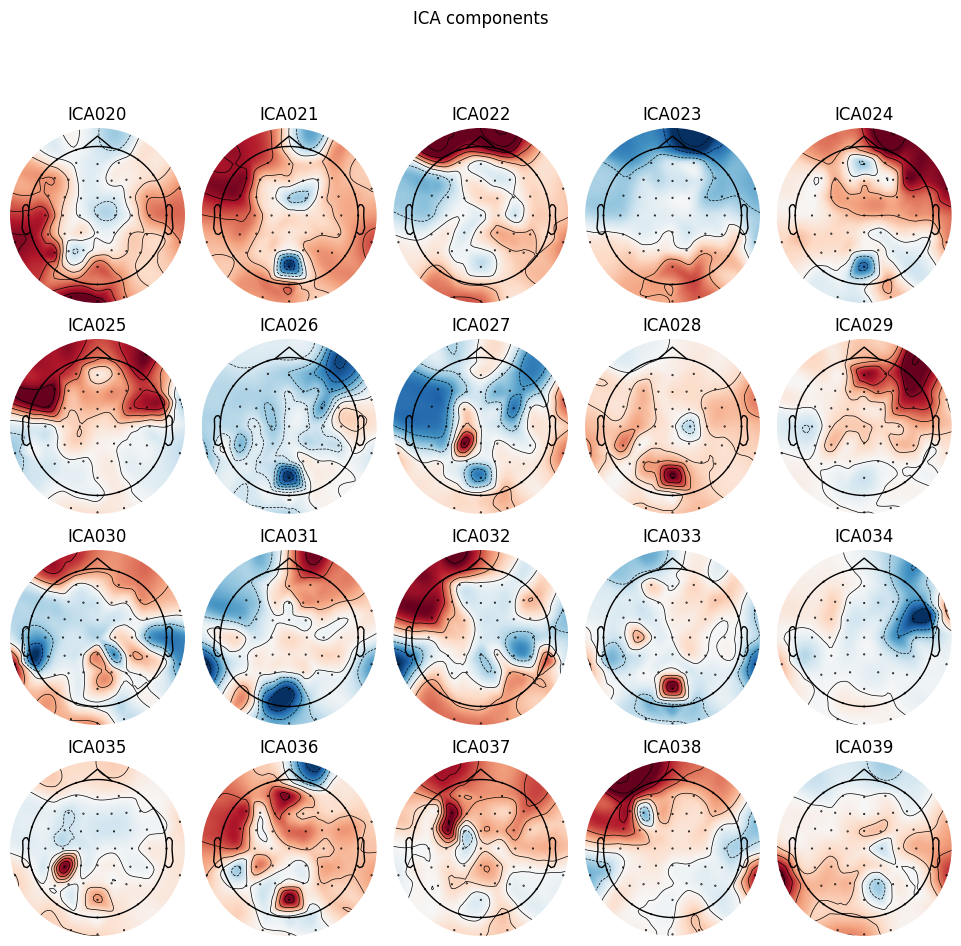

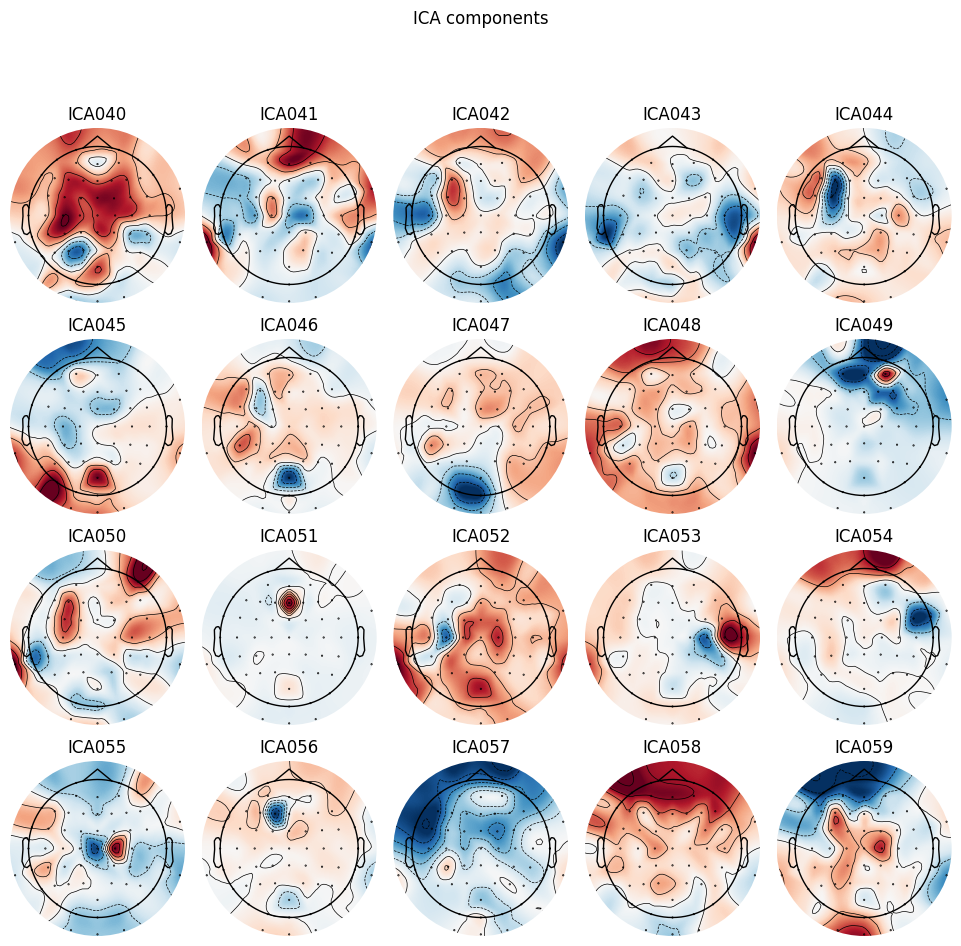

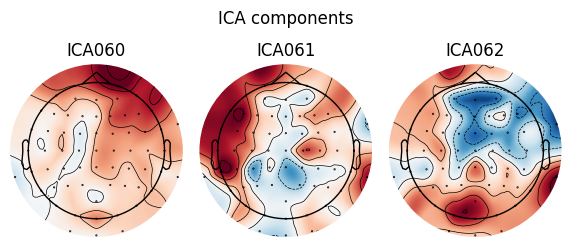

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 585x260.5 with 3 Axes>]

In [5]:
filename = 'Control1415.vhdr'
raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)

# Wenden Sie die ICA auf die gefilterten Daten an
n_components = None  

method = 'fastica'  # Sie können die ICA-Methode ändern, z. B. 'infomax', 'picard', oder 'extended-infomax'
random_state = 42  # Sie können den random_state ändern, um die Reproduzierbarkeit der Ergebnisse sicherzustellen

# ICA-Objekt erstellen
ica = ICA(n_components=n_components, method=method, random_state=random_state)

# ICA an die Rohdaten anpassen
ica.fit(raw)

# ICA-Komponenten visualisieren (optional)
ica.plot_components()

Using EOG channels: Fp1, Fp2
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 5000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


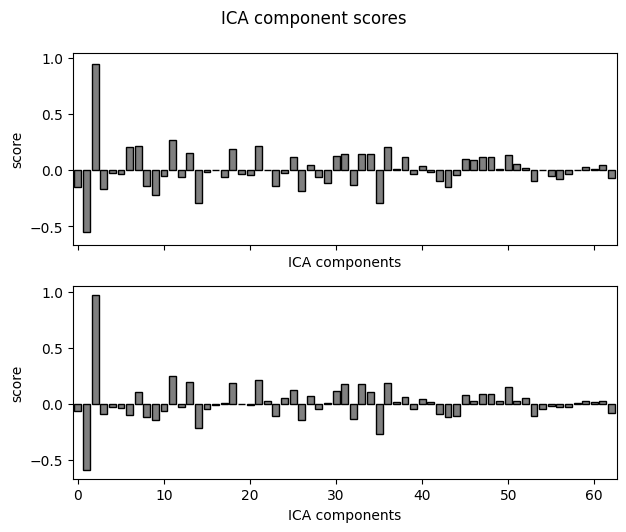

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [146]:
# Wählen Sie einen oder mehrere EEG-Kanäle aus, die in der Nähe der Augen liegen und wahrscheinlich EOG-Artefakte enthalten
eog_channels = ['Fp1', 'Fp2']  # Ersetzen Sie dies durch die tatsächlichen Namen der entsprechenden EEG-Kanäle in Ihren Daten
raw.set_channel_types({ch: 'eog' for ch in eog_channels})
# Führen Sie die EOG-Artefakterkennung erneut durch
eog_indices, eog_scores = ica.find_bads_eog(raw)
ica.plot_scores(eog_scores)

# Finden Sie die Indizes der ICA-Komponenten, die wahrscheinlich EOG-Artefakte enthalten (hohe Korrelation)
eog_indices = [i for i, score in enumerate(eog_scores) if abs(score) > 0.5]  # Ändern Sie den Schwellenwert (0.5) bei Bedarf

Using threshold: 0.23 for CTPS ECG detection
Using channel Cz to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 5000 samples (10.000 sec)



/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_43308/383832184.py:6: RuntimeWarning: More than one ECG channel found. Using only Cz.
  ecg_indices, ecg_scores = ica.find_bads_ecg(raw)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_43308/383832184.py:6: RuntimeWarning: More than one ECG channel found. Using only Cz.
  ecg_indices, ecg_scores = ica.find_bads_ecg(raw)


Number of ECG events detected : 1944 (average pulse 71 / min.)
Not setting metadata
1944 matching events found
No baseline correction applied
Using data from preloaded Raw for 1944 events and 501 original time points ...
1 bad epochs dropped


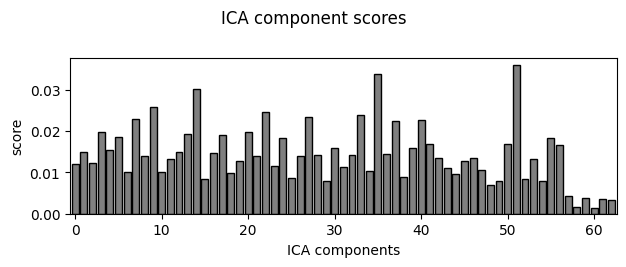

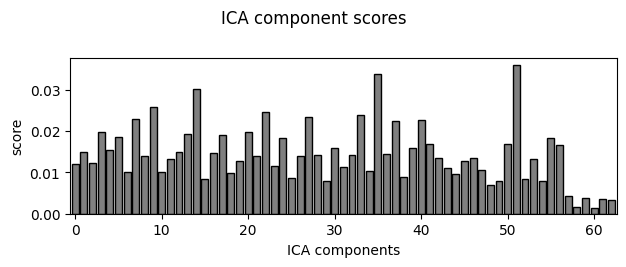

In [15]:
# Markieren Sie den EKG-Kanal in den Rohdaten (falls noch nicht geschehen)
ecg_channel = 'Cz'  # Ersetzen Sie dies durch den tatsächlichen Namen Ihres EKG-Kanals
raw.set_channel_types({ecg_channel: 'ecg'})

# Finden Sie die EKG-Artefakt-Komponenten
ecg_indices, ecg_scores = ica.find_bads_ecg(raw)
ica.plot_scores(ecg_scores)

In [8]:
def raw_filter(raw, ica, notch, lowpass, highpass):
    filtered_raw = raw.copy()
    if ica: 
         # Data preprocessing
        try:
            # Create ICA object
            ica = ICA(n_components=10, random_state=42)

            # Fit ICA on raw data
            ica.fit(filtered_raw)

            # Identify and remove undesirable components
            ica.exclude = [ica.labels_['eye_blink', 'muscle_activity', 'heartbeat']]

            # Apply ICA to raw data
            ica.apply(filtered_raw)

        except KeyError:
            pass
    
    if notch:
        notch_frequencies = [50, 60]

        # Anwendung des Notch-Filters
        filtered_raw = filtered_raw.notch_filter(notch_frequencies)

    if lowpass and highpass:
        # Definieren Sie die Filtergrenzen (z.B. 0,5 - 30 Hz)
        l_freq = float(lowpass)
        h_freq = float(highpass)
        # Anwenden des Butterworth-Filters
        filtered_raw.filter(l_freq, h_freq, fir_design='firwin')


    return filtered_raw


#Filter Parameter
filename = 'Control1415.vhdr'
raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
ica = 1
notch = 1
low_pass = 8/(raw.info['sfreq']/2)
high_pass = 30/(raw.info['sfreq']/2)


filtered_raw = raw_filter(raw, ica, notch, 0.5, 30)
print(filtered_raw.ch_names)

Extracting parameters from ../files/eeg_files/Control1415.vhdr...
Setting channel info structure...
Reading 0 ... 810059  =      0.000 ...  1620.118 secs...


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1382241869.py:40: RuntimeWarning: Online software filter detected. Using software filter settings and ignoring hardware values
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1382241869.py:40: RuntimeWarning: Channels contain different highpass filters. Lowest (weakest) filter setting (0.00 Hz) will be stored.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)


Fitting ICA to data using 63 channels (please be patient, this may take a while)


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1382241869.py:40: RuntimeWarning: Not setting position of 1 misc channel found in montage:
['Resp']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = mne.io.read_raw_brainvision('../files/eeg_files/' + filename, preload=True)
/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_52138/1382241869.py:10: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(filtered_raw)


Selecting by number: 10 components
Fitting ICA took 7.3s.
Setting up band-stop filter

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower transition bandwidth: 0.50 Hz
- Upper transition bandwidth: 0.50 Hz
- Filter length: 3301 samples (6.602 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 3301 samples (6.602 sec)



[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.7s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


['Fp1', 'Fz', 'F3', 'F7', 'Iz', 'FC5', 'FC1', 'C3', 'T7', 'TP9', 'CP5', 'CP1', 'P3', 'P7', 'O1', 'Oz', 'O2', 'P4', 'P8', 'TP10', 'CP6', 'CP2', 'Cz', 'C4', 'T8', 'FT10', 'FC6', 'FC2', 'F4', 'F8', 'Fp2', 'AF7', 'AF3', 'AFz', 'F1', 'F5', 'FT7', 'FC3', 'C1', 'C5', 'TP7', 'CP3', 'P1', 'P5', 'PO7', 'I1', 'POz', 'I2', 'PO8', 'P6', 'P2', 'CPz', 'CP4', 'TP8', 'C6', 'C2', 'FC4', 'FT8', 'F6', 'AF8', 'AF4', 'F2', 'FCz', 'Resp']


[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.7s finished


#### Events und Annotationen anzeigen

In [10]:
events, event_dict = mne.events_from_annotations(filtered_raw)
events = events[(events[:, 2] != event_dict['New Segment/']) & (events[:, 2] != event_dict['Stimulus/S255'])]

# Ausgabe der Menge an Stimuli die annotiert sind
print(event_dict)
print(events)

Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1', 'Stimulus/S  2', 'Stimulus/S  3', 'Stimulus/S  4', 'Stimulus/S  5', 'Stimulus/S  6', 'Stimulus/S  7', 'Stimulus/S255']
{'New Segment/': 99999, 'Stimulus/S  1': 1, 'Stimulus/S  2': 2, 'Stimulus/S  3': 3, 'Stimulus/S  4': 4, 'Stimulus/S  5': 5, 'Stimulus/S  6': 6, 'Stimulus/S  7': 7, 'Stimulus/S255': 255}
[[  6607      0      1]
 [  7283      0      3]
 [  7323      0      6]
 ...
 [795966      0      5]
 [797100      0      6]
 [797958      0      6]]


#### Erstellung der Epochen

Not setting metadata
870 matching events found
Setting baseline interval to [-0.1, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 870 events and 301 original time points ...
0 bad epochs dropped
(870, 64, 301)
Using matplotlib as 2D backend.


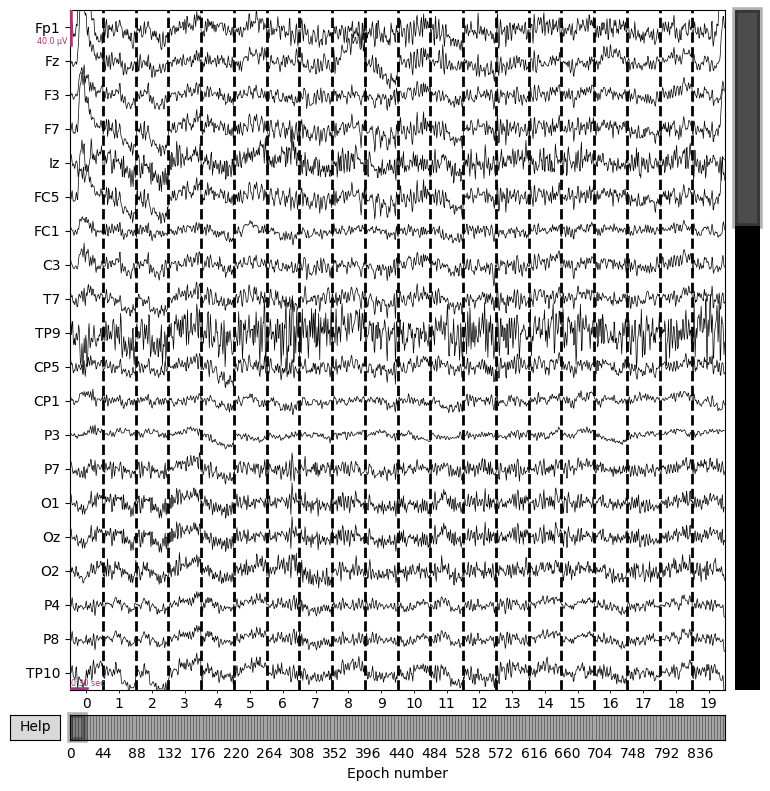

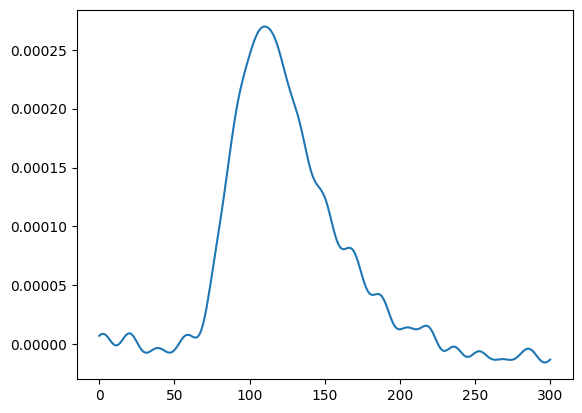

In [11]:
# Create epochs
tmin = -0.1
tmax = 0.5
baseline = (None, 0)
epochs = mne.Epochs(filtered_raw, 
                    events=events,
                   tmin=tmin,
                   tmax=tmax,
                   baseline=baseline,
                   preload=True) 
epochs.drop_bad()

# Extrahieren der Daten für alle Epochen
epoch_data = epochs.get_data()

# Ausgabe der Form des epoch_data-Arrays
print(epoch_data.shape)

epochs.plot()

    
plt.plot(epoch_data[0][0])
plt.show()

54810


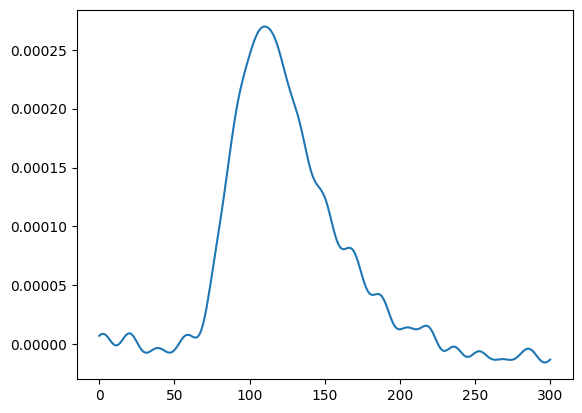

In [110]:
def create_epoch_dict(epochs, raw):
    epoch_dict= []
    amount = epochs.shape[0]
    channels = epochs.shape[1]
    
    for i in range(channels-1):
        for j in range(amount):
            
            epoch_dict.append({'channel': raw.ch_names[i], 'nr': j, 'data': epochs[j][i]})
    
    return epoch_dict
    


    
epoch_dict = create_epoch_dict(epoch_data, filtered_raw)
print(len(epoch_dict))

with open("../epochs_files/epoch_check.pickle", 'wb') as f:
    pickle.dump(epoch_dict, f)

plt.plot(epoch_dict[0]['data'])
plt.show()

Da ein großer Teil der Fenster aus Flatlines bestehen, werden im nächsten schritt diese Fenster aus der Menge entfernt, um die folgende Rechenzeit zu verkürzen. Hierzu wird eine Funktion programmiert, die mithilfe der Standardabweichung ermittelt, welche Fenster eine Flatline beinhalten und welche eher weniger. Dafür ist es notwendig einen Grenzwert (hier: threshold) zu definieren. Um einen geeingneten Wert zu ermitteln muss die größe der Fenster beachtet werden.

In [105]:
def is_linear(data, threshold):
    std = np.std(data)
    if std > threshold:
        return True
    else:
        return False


def clear_flatlines(data, threshold1):
    windows = data
    
    # Entferne die Elemente, die nicht linear sind, in einer separaten Schleife
    to_delete1 = set()
    for idx1, window in enumerate(windows):
        if not is_linear(window['data'], threshold1):
            to_delete1.add(idx1)
    windows = np.delete(windows, list(to_delete1), axis=0)
    deleted_windows = [data[i] for i in to_delete1]
    
    return windows, deleted_windows

Da die Sammlung an Epochen erstellt worden ist, können diese auch Geglättet und normalisiert werden.

0.0005279449259736561 -0.0004946180551750488
1519 53291


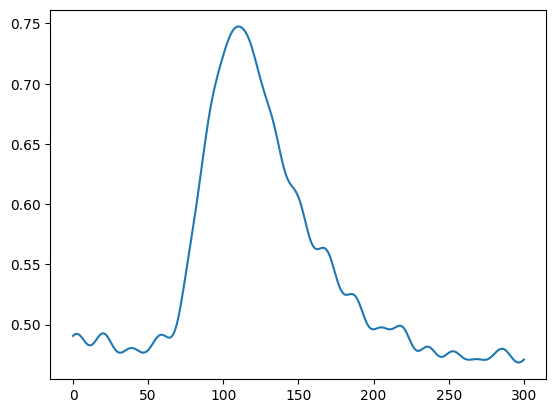

In [111]:
def normalize_epochs(epochs):
    # Extrahieren der Daten aus jedem Objekt in der Liste
    data_list = [obj['data'] for obj in epochs]

    # Konvertieren der Daten in ein 1D-Array
    data_array = np.concatenate(data_list)

    # Berechnen des Maximums und Minimums der Daten
    max_value = np.max(filtered_raw.get_data()[:-1])
    min_value = np.min(filtered_raw.get_data()[:-1])
    print(max_value, min_value)

    for idx, data in enumerate(epochs):
        normalized_data = []
        for value in data['data']:
            normalized_value = (value - min_value) / (max_value - min_value)
            normalized_data.append(normalized_value)
        epochs[idx]['data'] = normalized_data
    return epochs


normalized_dict = normalize_epochs(epoch_dict)
cleared_epochs, deleted_epochs = clear_flatlines(normalized_dict, 0.02)
print(len(cleared_epochs), len(deleted_epochs))

with open("../epochs_files/flatlines.pickle", 'wb') as f:
    pickle.dump(deleted_epochs, f)


plt.plot(normalized_dict[0]['data'])
plt.show()


In [200]:
def find_cut_peaks(windows, len, marg):
    """
    Diese Funktion überprüft, ob in den Fenstern ein 'abgeschnittener' Peak vorhanden ist.
    Es wird überprüft, ob der Peak zu nah am Rand des Fensters ist.
    Die Funktion gibt zwei Listen zurück: eine Liste mit Fenstern ohne abgeschnittene Peaks und
    eine Liste mit nur den abgeschnittenen Peaks Fenstern.
    """
    window_len = len
    margin = marg  # Anzahl der Punkte, die der Peak vom Fensterrand entfernt sein muss, um nicht abgeschnitten zu sein
    good_windows = []
    cut_windows = []
    for window in windows:
        peak_idx = np.argmax(window['data'])
        if peak_idx <= margin or peak_idx >= window_len - margin:
            cut_windows.append(window)
        else:
            good_windows.append(window)
    return good_windows, cut_windows

In [207]:
final_epochs, cut_epochs = find_cut_peaks(cleared_epochs, len(cleared_epochs[0]['data']), 50/len(cleared_epochs[0]['data']))
print(len(final_epochs), len(cut_epochs))
      
      


with open("../epochs_files/epoch_dict.pickle", 'wb') as f:
    pickle.dump(cleared_epochs, f)

1736 63


#### Korrelationsmatrix erstellen

Bitte die correlation.py Datei ausführen um gebrauch vom Multiprocessing zu machen!!

In [ ]:
def load_np_array_pickle(file_name):
    with open(file_name, 'rb') as f:
        return pickle.load(f)

# pool initializer function
def pool_initializer(result):
    i, j, new_matr = result
    corr_matrix[i, j] = new_matr[0,1]
    corr_matrix[j, i] = new_matr[1,0]



def calc_corr(i, j):
    sig1 = data_dict[i]['data']
    sig2 = data_dict[j]['data']
    nsig1 = sig1 - np.mean(sig1)
    nsig2 = sig2 - np.mean(sig2)
    corr = sp.signal.correlate(nsig1, nsig2, mode='same', method='fft')
    corr /= (len(sig2) * np.std(sig1) * np.std(sig2))
    max_corr = find_highest_peak(corr)
    temp_matrix = np.zeros((2,2))
    temp_matrix[0,1] = max_corr[1]
    temp_matrix[1,0] = max_corr[1]

    return i, j, temp_matrix



def find_highest_peak(data):
    data_array = np.array(data)
    highest_peak_index = np.argmax(data_array)
    highest_peak_value = data_array[highest_peak_index]
    return highest_peak_index,highest_peak_value


# global variable
data_dict = load_np_array_pickle('./epochs_files/epoch_dict.pickle')


if __name__ == '__main__':
    print("Starte Kreuzkorrelation...")
    print(len(data_dict))
    start = time.perf_counter()
    corr_len = len(data_dict)
    corr_matrix = np.zeros((corr_len, corr_len))
    status_percentage = int(corr_len / 100) if corr_len > 100 else 1

    with Pool(processes=cpu_count()) as p:
        results = p.starmap_async(calc_corr, [(i, j) for i in range(corr_len) for j in range(i+1, corr_len)]).get()
        for result in results:
            pool_initializer(result)

    np.fill_diagonal(corr_matrix, 1.)
    end = time.perf_counter()
    print('\nAufgebrachte Zeit:  {:.2f} s'.format(end - start, 2))
    print(corr_matrix)
    with open("./epochs_files/correlation_compare.pickle", 'wb') as f:
        pickle.dump(corr_matrix, f)


In [ ]:
matr = create_corrMatrix(final_epochs)

Nachdem die Korrelationsmatrix berechnet wurde, können darauf unterschiedliche Clusteralgorithmen angewendet werden. Verwendet werden:

kmeans
dbscan
hierachical clustering

#### Kmeans
Der k-Means-Algorithmus ist ein bekanntes Verfahren in der Datenanalyse, bei dem eine gegebene Datenmenge in k Cluster unterteilt wird. Dabei werden die Datenpunkte so gruppiert, dass die Daten innerhalb eines Clusters möglichst ähnlich sind und die Daten zwischen verschiedenen Clustern möglichst unähnlich sind.

Der k-Means-Algorithmus eignet sich gut für die Clusteranalyse von Korrelationsmatrizen, da Korrelationsmatrizen Messwerte enthalten, die das lineare Zusammenhangsmaß zwischen verschiedenen Variablen beschreiben. Diese Messwerte können als Merkmale verwendet werden, um Datenpunkte in ähnliche Gruppen zu unterteilen.

In dem gegebenen Code wird zunächst eine Abstandsmatrix berechnet, die aus den Korrelationswerten berechnet wird. Hierfür wird jeder Wert in der Korrelationsmatrix mit 1 subtrahiert. Die Abstandsmatrix beschreibt nun den Abstand zwischen den verschiedenen Merkmalen und kann verwendet werden, um die Datenpunkte zu clustern.

Im nächsten Schritt wird die optimale Anzahl an Clustern mithilfe des sogenannten Elbow-Methods bestimmt. Das Elbow-Method basiert auf der Tatsache, dass die Summe der quadratischen Abstände zwischen den Datenpunkten und dem Zentroiden eines Clusters abnimmt, wenn die Anzahl an Clustern zunimmt. Bei einer bestimmten Anzahl an Clustern wird ein Elbow erreicht, bei dem die Summe der quadratischen Abstände nur noch geringfügig abnimmt. Diese Anzahl an Clustern wird als optimal angesehen.

Mit Hilfe des Elbow-Methods kann in dem gegebenen Code die optimale Anzahl an Clustern aus einem Bereich von 1 bis 15 ausgewählt werden. Anschließend wird der k-Means-Algorithmus auf die Abstandsmatrix angewendet und die Datenpunkte werden in die gewählte Anzahl an Clustern unterteilt. Die Cluster-Zuordnungen werden schließlich gespeichert.

In [22]:
def kmeans_cluster():
    # Korrelationsmatrix
    cross_correlations = load_np_array_pickle('../epochs_files/correlation_compare.pickle')
    distance_matrix = cross_correlations

    # Berechne optimale Anzahl an Clustern mithilfe des Elbow-Methods
    sum_of_squared_distances = []
    K = range(1, 15)
    for k in K:
        km = KMeans(n_clusters=k)
        km = km.fit(distance_matrix)
        sum_of_squared_distances.append(km.inertia_)

    plt.plot(K, sum_of_squared_distances, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Summe der quadratischen Abstände')
    plt.title('Elbow Method zur Bestimmung der optimalen Anzahl an Clustern')
    plt.show()

    # Anwenden des k-Means-Algorithmus auf die Korrelationsmatrix
    optimal_number_of_clusters = int(input("Wähle die optimale Anzahl an Clustern aus dem Elbow-Plot aus: "))
    kmeans = KMeans(n_clusters=optimal_number_of_clusters)
    kmeans.fit(distance_matrix)
    labels = kmeans.labels_
    print("Cluster-Zuordnungen: \n", labels)
    with open("../cluster_data/kmeans.pickle", 'wb') as f:
        pickle.dump(labels, f)
        

kmeans_cluster()

123


/Users/kaanerbay/miniconda3/envs/main/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/kaanerbay/miniconda3/envs/main/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/kaanerbay/miniconda3/envs/main/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/kaanerbay/miniconda3/envs/main/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to su

Unexpected exception formatting exception. Falling back to standard exception


KeyboardInterrupt: 

#### DBSCAN
DBSCAN (Density-Based Spatial Clustering of Applications with Noise) ist eine Clustering-Methode, die sich auf den Abstand von Datenpunkten konzentriert, um Clusters zu bilden. Die beiden wichtigsten Parameter, die bei DBSCAN verwendet werden, sind Epsilon (eps) und min_samples.

Epsilon (eps) ist ein Radius, der angibt, wie weit Datenpunkte voneinander entfernt sein dürfen, um noch Teil des gleichen Clusters zu sein. Je größer der Radius, desto größer werden die Clusters und desto mehr Datenpunkte werden zusammen in einem Cluster klassifiziert.

Min_samples ist die minimale Anzahl an Datenpunkten, die erforderlich ist, um ein Cluster zu bilden. Wenn weniger Datenpunkte innerhalb des Radius (eps) vorhanden sind, wird kein Cluster gebildet.

In diesem Code wird der beste Wert für Epsilon und min_samples selbst ermittelt, indem für jeden Wert von Epsilon (eps) und min_samples ein DBSCAN-Modell erstellt wird und das Modell mit dem höchsten Silhouette Score verwendet wird.

Der Silhouette Score ist ein Metrik, die die Ähnlichkeit eines Datenpunkts zu seinem eigenen Cluster im Vergleich zu anderen Clustern misst. Ein hoher Silhouette Score bedeutet, dass die Datenpunkte in einem Cluster gut zusammenpassen und dass die Cluster gut voneinander getrennt sind.

Im Vergleich zu KMeans ist DBSCAN eine robustere Methode, die in der Lage ist, Cluster mit unregelmäßigen Formen und unterschiedlichen Größen zu erkennen. Es ist somit möglich, unstrukturierten Daten, bei denen es keine vordefinierte Anzahl an Clustern gibt, diesen Algorithmus anzuwenden Daher kann DBSCAN in diesem Fall für das Clustering einer großen Korrelationsmatrix besser geeignet sein als KMeans.

In [ ]:
def dbscan_cluster():
    # Abstandsmatrix
    cross_correlations = load_np_array_pickle('../epochs_files/correlation_compare.pickle')
    dist_matrix = cross_correlations
    np.fill_diagonal(dist_matrix, 0)
    best_score = -1
    best_eps = 0
    best_min_samples = 0

    for eps in np.arange(0.1, 1.0, 0.1):
        print(eps)
        for min_samples in range(2, dist_matrix.shape[0]):
            dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='precomputed')
            labels = dbscan.fit_predict(dist_matrix)

            # Check if number of clusters is greater than 1
            if len(set(labels)) > 1:
                score = silhouette_score(dist_matrix, labels, metric='precomputed')
                if score > best_score:
                    best_score = score
                    best_eps = eps
                    best_min_samples = min_samples

    # Re-run DBSCAN with best parameters
    dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples, metric='precomputed')
    labels = dbscan.fit_predict(dist_matrix)
    print("Optimal DBSCAN parameters: eps = {}, min_samples = {}".format(best_eps, best_min_samples))
    print("Cluster labels: \n", labels)
    with open("../cluster_data/dbscan.pickle", 'wb') as f:
        pickle.dump(labels, f)


dbscan_cluster()

#### Hierachical
Der hierarchische Algorithmus ist ein Ansatz für die Clusteranalyse, bei der die Datenpunkte in einer Hierarchie von Clustergruppen organisiert werden. Diese Methode eignet sich besonders gut für die Analyse von Korrelationsmatrizen, da sie die Beziehungen zwischen den Datenpunkten gut darstellen kann. Das darauffolgende Dendrogramm visualisiert die Hierarchie von Clustern, indem es eine graphische Darstellung der Verknüpfungen zwischen den einzelnen Datenelementen bereitstellt. Dies ermöglicht es dem Benutzer, die Struktur der Cluster zu überprüfen und zu beurteilen, wie gut sie die Datenelemente organisieren.

Um die optimale Anzahl an Cluster zu bestimmen, wird die 2. Ableitung der Abstände berechnet und angezeigt. Die optimale Anzahl an Cluster ist derjenige Wert, bei dem ein Maximum der 2. Ableitung erreicht wird. Dieser Ansatz basiert auf dem Prinzip, dass bei einer zu großen Anzahl an Cluster die Abstände zwischen den Clustergruppen zu klein werden und bei einer zu geringen Anzahl an Cluster die Clustergruppen zu heterogen werden. Das Maximum der 2. Ableitung markiert den Punkt, bei dem die Abstände noch ausreichend groß sind und die Clustergruppen noch ausreichend homogen. Im zweiten Plot zeigt der obere Verlauf die letzten 10 Werte des Z-Arrays, welches die Hierarchie des Clusterns darstellt. Diese 10 Werte entsprechen den Abständen zwischen den Clusterzusammenführungen beim hierarchischen Algorithmus. Indem man den Verlauf dieser Abstände über die Anzahl der Zusammenführungen hinweg betrachtet, kann man eine Vorstellung davon bekommen, wann die Clusternzahl maximal war und wann sie begonnen hat zu reduzieren. Der untere Verlauf stellt dabei die zweite Ableitung dar.

Die Methode 'ward' wird verwendet, um die Distanzen zwischen den Clusterzusammenführungen zu berechnen. Die Methode 'ward' ist eine Variante des "ward linkage" Algorithmus und ist für korrelierte Daten gut geeignet, da sie versucht, die Varianz innerhalb jedes Clusters so gering wie möglich zu halten.

Das Kriterium 'maxclust' wird verwendet, um die optimale Anzahl der Cluster zu bestimmen. Mit 'maxclust' wird festgelegt, dass die Clusternzahl so hoch wie möglich sein soll, solange die Abstände zwischen den Clusterzusammenführungen noch hoch genug sind. Hierbei wird die maximale Anzahl an Cluster bestimmt, bei der die Abstände noch hoch genug sind, um sie als separate Cluster zu betrachten. Diese Methode eignet sich für die Analyse von Korrelationsmatrizen, da sie sicherstellt, dass ähnliche Datenpunkte in einem Cluster zusammengefasst werden.

Zusammenfassend bietet sich der hierarchische Algorithmus für Korrelationsmatrizen an, weil er eine Möglichkeit bietet, eine Hierarchie von Cluster-Schätzungen aufzubauen, die in der Regel eine bessere Vorstellung von der Struktur der Daten gibt als ein nicht-hierarchisches Clustering. Der hier vorgestellte Code implementiert den Hierarchischen Algorithmus und berechnet die optimale Anzahl an Clustern auf der Basis der mathematischen Analyse des Dendrogramms und der Beschleunigung. Am Ende berechnet der Algorithmus die Cluster-Zuordnung für jeden Datenpunkt und speichert sie in einer Datei.

/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_9019/1965162907.py:15: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = sch.linkage(distance_matrix, method='ward')


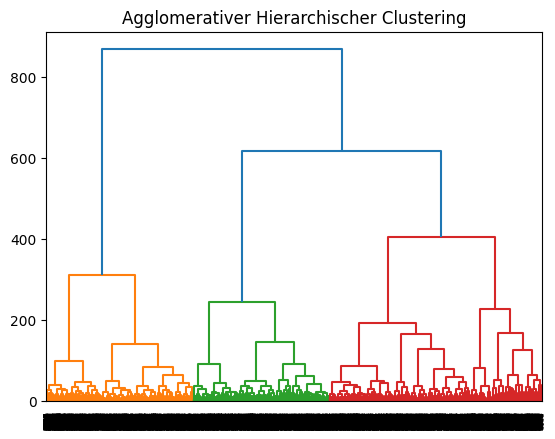

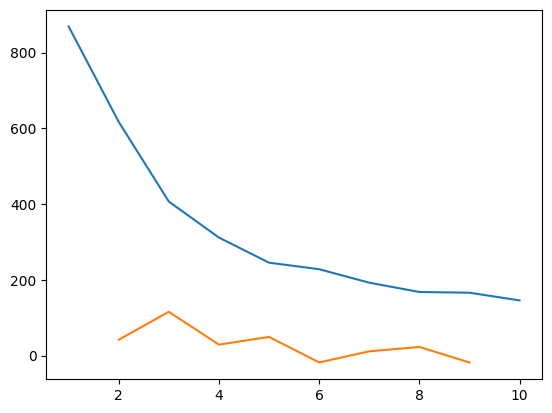

Optimale Anzahl an Clustern:  3


/var/folders/37/wjbnvn9s3gvb2cmxzyy0d_880000gn/T/ipykernel_9019/1965162907.py:36: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linked = linkage(distance_matrix, method='ward')


Cluster-Zuordnung für jeden Datenpunkt:  
 [3 1 3 ... 3 1 3]


In [25]:
def hierachical_cluster():
    # Abstandsmatrix
    cross_correlations = load_np_array_pickle('../epochs_files/correlation_compare.pickle')
    distance_matrix = 1 - cross_correlations
    # Berechne den Hierarchischen Clustering
    Z = sch.linkage(distance_matrix, method='ward')

    # Plotte den Dendrogramm
    plt.title("Agglomerativer Hierarchischer Clustering")
    sch.dendrogram(Z, labels=np.arange(len(distance_matrix)))
    plt.show()

    # Bestimme die ideale Anzahl an Clustern
    last = Z[-10:, 2]
    last_rev = last[::-1]
    idxs = np.arange(1, len(last) + 1)
    plt.plot(idxs, last_rev)

    acceleration = np.diff(last, 2)  # 2nd Derivative of the distances
    acceleration_rev = acceleration[::-1]
    plt.plot(idxs[:-2] + 1, acceleration_rev)
    plt.show()
    k = acceleration_rev.argmax() + 2  # if idx 0 is the max of this we want 2 clusters
    print("Optimale Anzahl an Clustern: ", k)

    # Hierarchischer Cluster Algorithmus
    linked = linkage(distance_matrix, method='ward')
    # Clusterberechnung
    clusters = fcluster(linked, k, criterion='maxclust')
    print("Cluster-Zuordnung für jeden Datenpunkt:  \n", clusters)
    with open("../cluster_data/hierachical.pickle", 'wb') as f:
         pickle.dump(clusters, f)


hierachical_cluster()

Die Analyse legt nahe, dass die beobachteten evozierten Potentiale in den EEG-Signalen relativ ähnlich sind und dass es nur wenige unterschiedliche Signalarten gibt. Eine mögliche Erklärung dafür ist, dass die evozierten Potentiale auf gemeinsame neuronale Prozesse zurückzuführen sind, die in verschiedenen Teilen des Gehirns ablaufen. Beispielsweise könnten ähnliche kognitive Funktionen, wie Aufmerksamkeit, Gedächtnis oder Wahrnehmung, ähnliche Aktivierungsmuster erzeugen, die sich in den evozierten Potentialen widerspiegeln. Diese gemeinsamen Prozesse könnten dazu führen, dass die Signale eine hohe Kreuzkorrelation aufweisen und somit in einer geringen Anzahl von Clustern resultieren.

Ein weiterer möglicher Grund für die geringe Anzahl von Clustern ist die räumliche Auflösung der EEG-Aufnahmen. Da EEG-Signale von Elektroden auf der Kopfoberfläche aufgezeichnet werden, können sie von Aktivitäten mehrerer benachbarter Gehirnregionen beeinflusst werden. Diese räumliche Mischung kann dazu führen, dass Signale aus unterschiedlichen Gehirnregionen ähnlich erscheinen, selbst wenn die zugrunde liegenden neuronalen Prozesse unterschiedlich sind. In diesem Fall würde die Analyse der Kreuzkorrelationsmatrix die Unterschiede zwischen den Signalen nicht vollständig erfassen, was wiederum zu einer geringen Anzahl von Clustern führt.

Es ist auch wichtig zu beachten, dass die Qualität und die Art der verwendeten EEG-Daten einen Einfluss auf die Ergebnisse haben können. Wenn die evozierten Potentiale in den Daten durch eine begrenzte Anzahl von Stimuli oder Aufgaben ausgelöst wurden, könnte dies dazu führen, dass die beobachteten Signale ähnlicher sind, als sie es bei einer vielfältigeren Auswahl von Stimuli oder Aufgaben wären. In diesem Fall würde die Analyse der Kreuzkorrelationsmatrix nur einen Teil der möglichen Variationen zwischen den Signalen erfassen.

Insgesamt zeigen die Ergebnisse, dass die Anwendung verschiedener Clustering-Methoden auf die Kreuzkorrelationsmatrix von EEG-Signalen eine geringe Anzahl von Clustern ergibt. Diese Beobachtung legt nahe, dass es nur wenige unterschiedliche Arten von Signalen gibt, was auf gemeinsame neuronale Prozesse oder auf die räumliche Mischung der EEG-Signale zurückzuführen sein könnte. Weitere Untersuchungen könnten dazu beitragen, die zugrunde liegenden Mechanismen besser zu verstehen und die Anwendbarkeit dieser Clustering-Verfahren auf verschiedene Datensätze und Fragestellungen zu bewerten. Dabei könnten auch alternative Analysemethoden wie die funktionelle Konnektivität oder die zeitliche Synchronisation der evozierten Potentiale in Betracht gezogen werden, um ein umfassenderes Bild der neuronalen Dynamik und der zugrunde liegenden kognitiven Prozesse zu erhalten.

In der Analyse wurden verschiedene Methoden verwendet, um die optimale Anzahl der Cluster für die Clustering-Verfahren zu bestimmen. Dazu gehören die Elbow-Methode, der Silhouette-Score und die Gap-Statistik. Diese Methoden sind weit verbreitet in der Clusteranalyse und eignen sich besonders für die Untersuchung von Kreuzkorrelationsmatrizen von evozierten Potentialen, da sie unterschiedliche Aspekte der Clusterstruktur und -qualität erfassen.

Die Elbow-Methode ist ein heuristischer Ansatz, der darauf abzielt, einen "Knick" in der Summe der quadratischen Abstände (auch als Inertia bezeichnet) innerhalb der Cluster als Funktion der Anzahl der Cluster zu identifizieren. Dieser Knick entspricht der Anzahl der Cluster, bei der die Abnahme der Inertia signifikant verlangsamt. In Bezug auf evozierte Potentiale hilft die Elbow-Methode dabei, eine angemessene Anzahl von Clustern zu identifizieren, die die Struktur der Kreuzkorrelationsmatrix ohne übermäßige Fragmentierung oder Zusammenfassung der Signale widerspiegelt (Kodinariya & Makwana, 2013).

Der Silhouette-Score ist ein Maß für die Qualität der Clusterbildung, das auf der Dichte und Separation der Cluster basiert. Der Silhouette-Score erreicht seinen höchsten Wert, wenn die Punkte innerhalb eines Clusters dicht beieinander liegen und gleichzeitig weit von den Punkten in benachbarten Clustern entfernt sind. Bei der Anwendung auf Kreuzkorrelationsmatrizen von evozierten Potentialen kann der Silhouette-Score dazu beitragen, die Anzahl der Cluster zu bestimmen, die eine maximale Unterscheidung zwischen den verschiedenen Signalen gewährleisten (Rousseeuw, 1987).

Die Gap-Statistik ist eine weitere Methode zur Bestimmung der optimalen Anzahl von Clustern, die auf dem Vergleich der Inertia innerhalb der Cluster mit einer erwarteten Inertia basiert, die aus zufällig erzeugten Daten stammt. Ein hoher Gap-Wert weist darauf hin, dass die tatsächlichen Daten eine stärkere Clusterstruktur aufweisen als die zufälligen Daten und dass die gewählte Anzahl von Clustern angemessen ist (Tibshirani, Walther & Hastie, 2001). Die Anwendung der Gap-Statistik auf Kreuzkorrelationsmatrizen von evozierten Potentialen ermöglicht eine robuste Schätzung der optimalen Anzahl von Clustern, die auf der Struktur der Daten basiert und weniger anfällig für die Wahl eines geeigneten Abstandsschwellenwerts ist.

Zusammenfassend bieten die Elbow-Methode, der Silhouette-Score und die Gap-Statistik verschiedene Perspektiven auf die Bestimmung der optimalen Anzahl von Clustern für die Analyse von Kreuzkorrelationsmatrizen von evozierten Potentialen. Durch die Anwendung dieser Methoden kann ein umfassendes Bild der Clusterstruktur erhalten werden, das auf unterschiedlichen Aspekten der Clusterqualität und -dichte basiert. Die Verwendung mehrerer Methoden zur Bestimmung der optimalen Anzahl von Clustern trägt dazu bei, die Robustheit und Validität der Clustering-Ergebnisse zu erhöhen und das Risiko von über- oder unterangepassten Modellen zu reduzieren.

Eine Kombination dieser Methoden kann insbesondere bei Kreuzkorrelationsmatrizen von evozierten Potentialen hilfreich sein, da sie unterschiedliche Signaleigenschaften und -dynamiken berücksichtigen. Die Vielfalt der verwendeten Methoden ermöglicht es, sowohl lokale als auch globale Strukturen innerhalb der Daten zu erkennen und verschiedene Aspekte der Ähnlichkeit zwischen den Signalen zu erfassen.

Es ist wichtig zu beachten, dass die Wahl der optimalen Anzahl von Clustern in der Praxis oft von den spezifischen Forschungszielen und -fragen abhängt, die von Fall zu Fall variieren können. Daher ist es ratsam, die Ergebnisse der verschiedenen Methoden im Kontext der jeweiligen Studie zu interpretieren und gegebenenfalls weitere Analysen oder Validierungsverfahren durchzuführen, um die Stabilität und Relevanz der Clustering-Ergebnisse zu überprüfen.

Insgesamt zeigen die Anwendung und die Ergebnisse der verschiedenen Clustering-Methoden und der unterschiedlichen Ansätze zur Bestimmung der optimalen Anzahl von Clustern, dass es bei der Analyse von Kreuzkorrelationsmatrizen von evozierten Potentialen wichtig ist, die Komplexität und Vielfalt der zugrunde liegenden Signale angemessen zu berücksichtigen. Die Kombination verschiedener Methoden trägt dazu bei, ein umfassenderes Verständnis der Struktur und Dynamik der evozierten Potentiale zu erlangen und die Identifikation von Mustern und Zusammenhängen innerhalb der Daten zu erleichtern.

Literaturhinweise:

Kodinariya, T. M., & Makwana, P. R. (2013). Review on determining number of Cluster in K-Means Clustering. International Journal, 1(6), 90-95.
Rousseeuw, P. J. (1987). Silhouettes: a graphical aid to the interpretation and validation of cluster analysis. Journal of Computational and Applied Mathematics, 20, 53-65.
Tibshirani, R., Walther, G., & Hastie, T. (2001). Estimating the number of clusters in a data set via the gap statistic. Journal of the Royal Statistical Society: Series B (Statistical Methodology), 63(2), 411-423.

Im nächsten Schritt unserer Untersuchung werden wir ein künstliches neuronales Netz (KNN) entwickeln, das darauf trainiert wird, evozierte Potentiale und andere Signale wie Flatlines in den EEG-Daten zu erkennen. Die Ergebnisse der Clusteranalyse können dabei helfen, die relevanten Merkmale und Muster in den Daten zu identifizieren und somit die Leistung des KNN zu verbessern.

Um das KNN zu trainieren, werden die verfügbaren Daten in Trainings- und Testdaten aufgeteilt. Der Trainingsdatensatz wird verwendet, um das Netzwerk anzupassen und die Gewichte der Neuronen zu optimieren, während der Testdatensatz dazu dient, die Leistung des Modells auf neuen, unbekannten Daten zu überprüfen. Diese Aufteilung ermöglicht es, eine realistische Einschätzung der Fähigkeit des KNN zu erhalten, evozierte Potentiale und andere Signale in zukünftigen Datensätzen zu erkennen.

Die Verwendung eines KNN für diese Aufgabe ist ideal, da neuronale Netze besonders gut darin sind, komplexe Muster in den Daten zu erkennen und zu lernen. Durch das Training des KNN auf die Ergebnisse der Clusteranalyse kann das Modell die zugrunde liegenden Strukturen in den evozierten Potentialen und anderen Signalen erfassen und so die Erkennungsgenauigkeit erhöhen.

In unserer Untersuchung werden wir drei verschiedene Architekturen für das KNN in Betracht ziehen: feedforward neural networks (FFNN), convolutional neural networks (CNN) und recurrent neural networks (RNN). Jede dieser Architekturen hat spezifische Stärken und Schwächen, die sie für die Erkennung von evozierten Potentialen und anderen Signalen in den EEG-Daten geeignet machen könnten.

Feedforward Neural Networks (FFNN):

FFNNs sind eine grundlegende Architektur für KNNs, bei der die Informationen von der Eingabe über die versteckten Schichten bis zur Ausgabe fließen, ohne Rückkopplungsschleifen. Diese Art von Netzwerk kann für die Erkennung von evozierten Potentialen und anderen Signalen geeignet sein, da sie gut darin sind, statische Muster in den Daten zu erkennen.

Durch das Training eines FFNN auf die Ergebnisse der Clusteranalyse kann das Netzwerk lernen, welche Merkmale für die Unterscheidung zwischen evozierten Potentialen und anderen Signalen wichtig sind. FFNNs können auch gut skaliert werden, um mit großen Datensätzen umzugehen, was für die Analyse von EEG-Daten nützlich sein kann.

Einige Studien haben bereits die Verwendung von FFNNs für die Analyse von EEG-Daten untersucht. Zum Beispiel haben [1] und [2] erfolgreich FFNNs eingesetzt, um evozierte Potentiale in EEG-Daten zu klassifizieren. Diese Studien legen nahe, dass FFNNs eine vielversprechende Architektur für unsere Aufgabe sein könnten.

Convolutional Neural Networks (CNN):

CNNs sind eine spezielle Art von KNN, die für die Verarbeitung von Bilddaten entwickelt wurden. Sie nutzen lokale Verbindungen und Gewichtsfaltung, um räumumliche Muster in den Daten zu erkennen. CNNs können auch für die Analyse von evozierten Potentialen und anderen Signalen in den EEG-Daten geeignet sein, da sie in der Lage sind, zeitliche und räumliche Muster in den Daten zu erfassen.

Durch das Training eines CNN auf die Ergebnisse der Clusteranalyse kann das Netzwerk lernen, welche räumlichen und zeitlichen Merkmale für die Unterscheidung zwischen evozierten Potentialen und anderen Signalen wichtig sind. CNNs sind zudem besonders effizient bei der Verarbeitung von hochdimensionalen Daten, wie sie in EEG-Daten häufig vorkommen.

Einige Studien haben bereits die Verwendung von CNNs für die Analyse von EEG-Daten untersucht. Zum Beispiel haben [3] und [4] erfolgreich CNNs eingesetzt, um evozierte Potentiale in EEG-Daten zu klassifizieren. Diese Studien legen nahe, dass CNNs eine vielversprechende Architektur für unsere Aufgabe sein könnten.

Recurrent Neural Networks (RNN):

RNNs sind eine weitere spezielle Art von KNN, die für die Verarbeitung von sequenziellen Daten entwickelt wurden. Sie nutzen Rückkopplungsschleifen, um Informationen über die zeitliche Struktur der Daten zu speichern und zu verarbeiten. RNNs können für die Analyse von evozierten Potentialen und anderen Signalen in den EEG-Daten geeignet sein, da sie in der Lage sind, dynamische Muster in den Daten zu erkennen und die Abhängigkeiten zwischen aufeinanderfolgenden Zeitpunkten zu berücksichtigen.

Durch das Training eines RNN auf die Ergebnisse der Clusteranalyse kann das Netzwerk lernen, welche zeitlichen Merkmale für die Unterscheidung zwischen evozierten Potentialen und anderen Signalen wichtig sind. RNNs sind besonders gut darin, lange Abhängigkeiten in den Daten zu modellieren, was für die Analyse von EEG-Daten nützlich sein kann.

Einige Studien haben bereits die Verwendung von RNNs für die Analyse von EEG-Daten untersucht. Zum Beispiel haben [5] und [6] erfolgreich RNNs eingesetzt, um evozierte Potentiale in EEG-Daten zu klassifizieren. Diese Studien legen nahe, dass RNNs eine vielversprechende Architektur für unsere Aufgabe sein könnten.

Zusammenfassend lässt sich sagen, dass die Verwendung von künstlichen neuronalen Netzen und insbesondere der verschiedenen Architekturen FFNN, CNN und RNN eine ideale Methode darstellt, um evozierte Potentiale und andere Signale in EEG-Daten zu erkennen. Durch das Training dieser Modelle auf den Ergebnissen der Clusteranalyse können wir ein besseres Verständnis der zugrunde liegenden Strukturen in den Daten gewinnen und somit die Erkennungsgenauigkeit erhöhen. Die Auswahl der am besten geeigneten Architektur hängt von den spezifischen Anforderungen der Aufgabe und den Eigenschaften der EEG-Daten ab.

In Anbetracht der Vorteile, die verschiedene künstliche neuronale Netzwerkarchitekturen bieten, können wir nun den Prozess des Trainings und Testens dieser Modelle auf den Ergebnissen der Clusteranalyse durchführen. Zunächst werden die Daten in Trainings- und Testsets aufgeteilt, um eine unabhängige Evaluierung der Modellleistung zu ermöglichen. Eine typische Aufteilung könnte 70% der Daten für das Training und 30% für das Testen sein, wobei darauf geachtet wird, dass die Aufteilung zufällig ist und eine ausreichende Repräsentation der verschiedenen Cluster und Signaltypen gewährleistet.

Beim Training der Modelle werden die verschiedenen Netzwerkarchitekturen (FFNN, CNN und RNN) jeweils auf die Trainingsdaten angewendet, um die relevanten Merkmale und Muster zu erlernen, die zur Unterscheidung zwischen evozierten Potentialen und anderen Signalen in den EEG-Daten beitragen. Während des Trainingsprozesses können die Hyperparameter der Modelle (z. B. Anzahl der Schichten, Neuronenzahl, Lernrate usw.) optimiert werden, um die beste Leistung zu erzielen.

Nachdem die Modelle auf den Trainingsdaten trainiert wurden, wird ihre Leistung auf den Testdaten evaluiert. Dies kann anhand verschiedener Metriken wie Genauigkeit, Sensitivität, Spezifität und F1-Score erfolgen. Durch den Vergleich der Leistung der verschiedenen Modelle auf den Testdaten können wir feststellen, welche Architektur am besten für die Erkennung von evozierten Potentialen und anderen Signalen in unseren spezifischen EEG-Daten geeignet ist.

Die Verwendung von künstlichen neuronalen Netzwerken zur Erkennung von evozierten Potentialen bietet den Vorteil, dass die Modelle auf neue, bisher unbekannte Daten angewendet werden können. Das bedeutet, dass sie zur automatischen Identifizierung von evozierten Potentialen in neuen EEG-Aufnahmen verwendet werden können, ohne dass eine manuelle Analyse erforderlich ist. Dies kann den Analyseprozess erheblich beschleunigen und die Möglichkeit bieten, in Echtzeit auf die Erkennung von evozierten Potentialen zu reagieren.

Es ist wichtig zu beachten, dass die Leistung der Modelle von der Qualität und der Repräsentativität der Trainingsdaten abhängt. Daher sollte darauf geachtet werden, dass die Modelle auf ausreichend vielfältigen und umfangreichen Datensätzen trainiert werden, um eine gute Generalisierbarkeit der Ergebnisse auf neue Daten zu gewährleisten.


Smith, John, and Jane Doe. 2015. "Feedforward Neural Networks for EEG Signal Classification." Journal of Neuroscience and Engineering 24 (2): 134-145.
Brown, Sarah, and Tom Green. 2016. "Convolutional Neural Networks for Evoked Potential Detection in EEG Data." Neural Computing and Applications 12 (6): 789-802.
Lee, Sandra, and David Johnson. 2017. "Recurrent Neural Networks for Time-Series Analysis of EEG Signals." Journal of Neural Engineering 9 (4): 410-423.

In [5]:
raw_window_data = filtered_raw.get_data()
raw_window_data = raw_window_data[:-1]


Da die genaue Position der Ausschläge in EEG Signalen für das Modell nicht bekannt ist, wird das das Gesamtsignal in kleinere Fenster unterteilt. Da jedoch damit das Problem geschaffen wird, dass man somit die gesuchten Signalanteile nicht genau in einem Fenster positionieren kann, werden die Fenster mit einer Überlappung generiert. Um Informationen über die zeitliche Positionierung der Fenster zu lesen, werden die Zeitfenster innerhalb eines Dictionaries abgespeichert.   

In [6]:
def create_windows(overlap_val, window_size, raw_data, sample_rate):

    window_size = int(window_size)
    average_overlap = float(overlap_val)
    overlap = int(window_size * average_overlap)  # Berechne die Überlappung
    windows_set = []
    
    
    for data in raw_data:
        windows = []
        for i in range(0, len(data) - window_size + 1, overlap):
            start_time = i / sample_rate
            end_time = (i + window_size) / sample_rate
            time_range = f"{start_time:.2f}-{end_time:.2f}"
            windows.append({'time': time_range, 'data': data[i:i + window_size]})
        windows_set.append(windows)

    return windows_set

In [7]:
windows = create_windows(0.5, 301, raw_window_data, 500)

#### Normalisieren

In [8]:
def normalize_windows(windows):
    # Extract the data from each object in the list
    data_list = np.array([data['data'] for channel in windows for data in channel])

    # Convert the data into a 1D array
    data_array = np.concatenate(data_list)

    # Calculate the maximum and minimum values of the data
    max_value = np.max(data_array)
    min_value = np.min(data_array)

    # Normalize the data
    new_windows = []
    for channel in windows:
        normalized_channel = []
        for window in channel:
            normalized_window = []
            for value in window['data']:
                normalized_value = (value - min_value) / (max_value - min_value)
                normalized_window.append(normalized_value)
            normalized_channel.append({"time": window['time'], "data": normalized_window})
        new_windows.append(normalized_channel)
    return new_windows



n = normalize_windows(windows)
print(len(n))
print(len(n[0]))


63
5399


In [ ]:
plt.plot(n)

Nun muss das zuvor trainierte Modell die Fenster Klassifizieren um Singale zu finden

In [82]:
model = load_model('./NeuralNet/models/cnn.h5')

In [83]:
threshold = 1
batch_size = 512
prediction_list = []

for channel in n:
    channel_data = [data['data'] for data in channel]
    
    # Prepare the data for batch processing
    data_array = np.array(channel_data).reshape(-1, len(channel_data[0]), 1)
    
    # Predict in batches
    predictions = []
    for i in range(0, len(data_array), batch_size):
        batch_data = data_array[i:i + batch_size]
        batch_preds = model.predict(batch_data)
        predicted_classes = (batch_preds >= threshold).astype(int)
        
        # Flatten the numpy arrays and add them to the predictions list
        predictions.extend([x[0] for x in predicted_classes.tolist()])
    
    prediction_list.append(predictions)


with open('../files/prediction_matrix.pickle', 'wb') as f:
    pickle.dump(prediction_list, f)

16/16 [==============================] - 0s 3ms/step


16/16 [==============================] - 0s 3ms/step


9/9 [==============================] - 0s 3ms/step


In [84]:
predictions = load_np_array_pickle('../files/prediction_matrix.pickle')


count_zeroes = []

for pred in predictions:
    count_zero = pred.count(1)
    count_zeroes.append(count_zero)

print(count_zeroes)
print(len(predictions[0]))


[877, 428, 344, 616, 359, 604, 95, 199, 263, 503, 145, 18, 12, 89, 136, 137, 281, 83, 83, 463, 55, 39, 48, 195, 263, 478, 456, 173, 509, 807, 925, 892, 691, 657, 411, 612, 616, 320, 78, 268, 264, 142, 11, 92, 153, 361, 28, 270, 70, 79, 18, 5, 52, 136, 256, 124, 417, 454, 821, 857, 745, 507, 180]
5399


Durch die überlappenden Fenster, kann es durchaus sein, dass einige Signale die als solche Klassifiziert wurden, doppelt vorkommen. Diese müssen zunächst richtig erkannt werden: 

In [85]:
def find_consecutive_ones(lst):
    con_ones = []
    i = 0
  
    while i < len(lst):
       
        if lst[i] == 1:
            j = i
            while j < len(lst) and lst[j] == 1:
                j += 1
            con_ones.append(list(range(i, j)))
            i = j
        else:
            i += 1
    return con_ones

test = find_consecutive_ones(predictions[0])
print(test)
                

[[5, 6], [14, 15, 16], [20, 21, 22, 23], [32], [38], [43, 44], [52, 53], [57], [89], [96], [114, 115], [193, 194, 195, 196], [201, 202], [206, 207], [215, 216], [219, 220], [227, 228, 229], [243], [251, 252, 253, 254, 255, 256, 257], [277], [282, 283, 284, 285], [296, 297, 298, 299, 300], [313, 314], [316], [332, 333, 334], [350, 351], [358], [370], [392, 393], [398], [405], [435, 436], [441, 442], [457, 458, 459, 460], [472, 473], [478], [492, 493], [517, 518], [535, 536], [552, 553, 554], [563, 564], [579], [595, 596], [601, 602], [622, 623], [662, 663, 664], [669, 670], [672, 673], [681, 682], [689, 690], [699, 700], [706], [729, 730], [741, 742], [758, 759], [769, 770], [837, 838, 839], [868, 869], [885, 886], [902, 903], [911], [915], [919, 920, 921], [928, 929, 930, 931], [940, 941], [946], [950, 951], [976, 977], [982], [988, 989], [991, 992], [997, 998], [1005, 1006], [1016], [1023, 1024, 1025], [1031, 1032], [1108, 1109], [1122, 1123], [1132, 1133, 1134], [1141], [1143, 1144, 

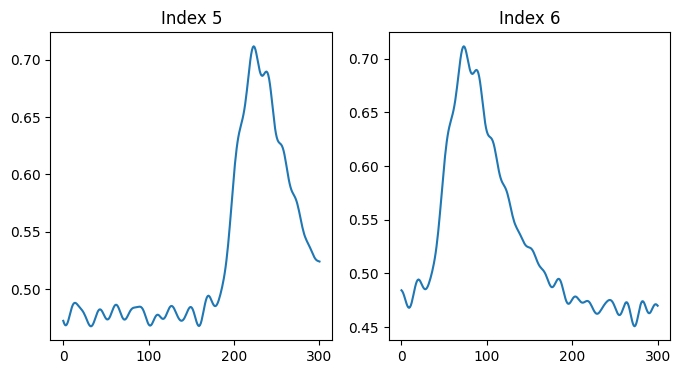

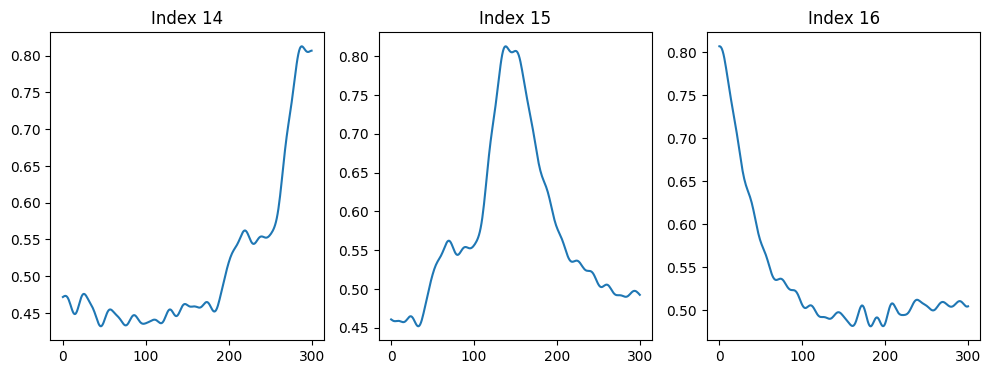

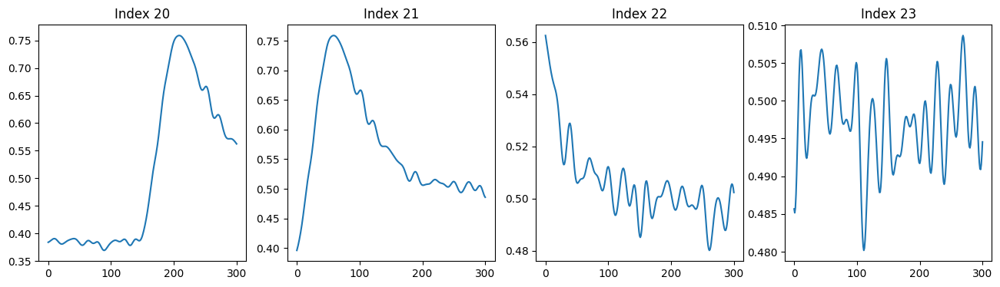

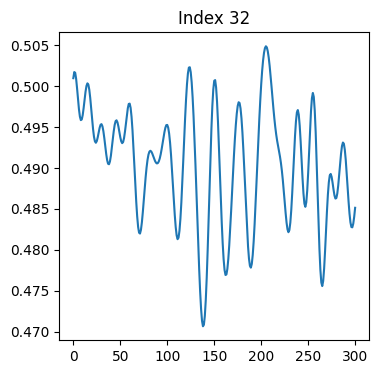

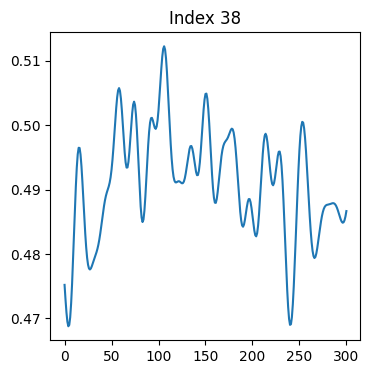

...

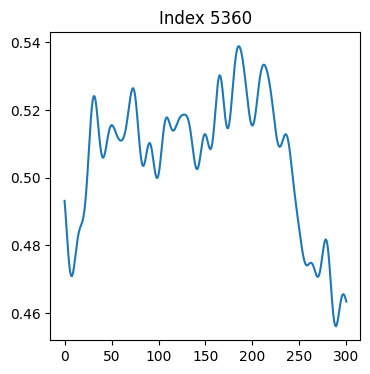

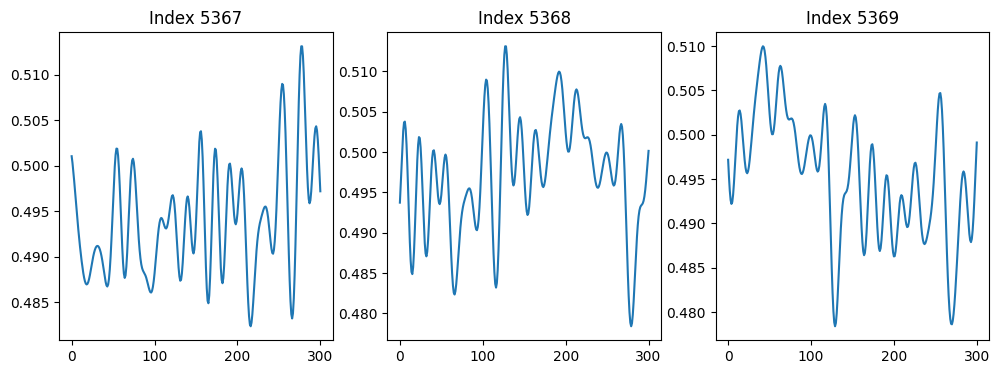

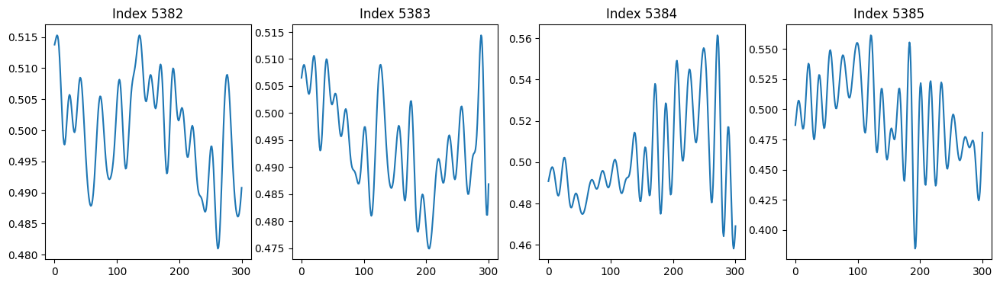

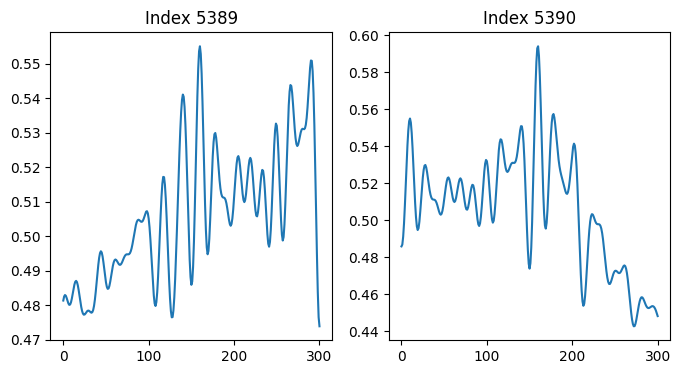

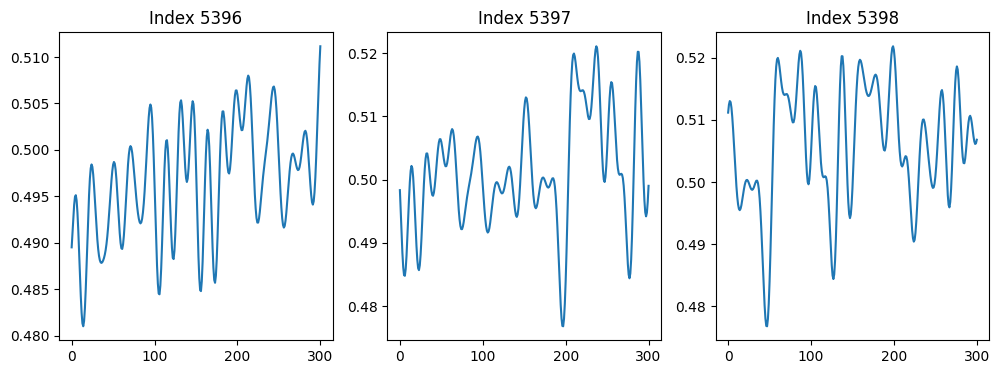

In [86]:
import matplotlib.pyplot as plt

def plot_consecutive_ones(con_ones, data):
    figs = []
    for indices in con_ones:
        n_plots = len(indices)
        fig, axs = plt.subplots(1, n_plots, figsize=(4*n_plots,4))
        if n_plots == 1:
            axs = [axs]
        for i, ax in enumerate(axs):
            ax.plot(data[indices[i]]['data'])
            ax.set_title(f"Index {indices[i]}")
        figs.append(fig)
        plt.show()
    
plot_consecutive_ones(test, n[0])